# How to Train YOLOv10 for face detection and face blur

## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [ ]:
!nvidia-smi

Wed Jun 26 10:06:29 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   65C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

**NOTE:** To make it easier for us to manage datasets, images and models we create a `HOME` constant.

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


## Clone and Install

In [ ]:
!git clone https://github.com/THU-MIG/yolov10.git
%cd yolov10
!pip install -r requirements.txt -q

Cloning into 'yolov10'...
remote: Enumerating objects: 20304, done.
remote: Counting objects: 100% (1347/1347), done.
remote: Compressing objects: 100% (127/127), done.
remote: Total 20304 (delta 1301), reused 1224 (delta 1220), pack-reused 18957
Receiving objects: 100% (20304/20304), 11.18 MiB | 24.04 MiB/s, done.
Resolving deltas: 100% (14304/14304), done.
/content/yolov10
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 619.9/619.9 MB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.0/6.0 MB 95.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.6/14.6 MB 92.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 97.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 426.2/426.2 kB 35.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.6/38.6 MB 14.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 91.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.8/199.8 

**NOTE:** Let's install the [`roboflow`](https://pypi.org/project/roboflow) package, which we will use to download our dataset from [Roboflow Universe](https://universe.roboflow.com/).

In [ ]:
!pip install -q roboflow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.0 MB/s eta 0:00:00


## Libraries

In [ ]:
import os
import shutil

## Download model weights

In [ ]:
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10n.pt
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10s.pt
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10m.pt
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10b.pt
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10l.pt
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10x.pt

In [ ]:
!ls -lahS {HOME}/weights

total 408M
-rw-r--r-- 1 root root 123M May 26 15:54 yolov10x.pt
-rw-r--r-- 1 root root 100M May 26 15:53 yolov10l.pt
-rw-r--r-- 1 root root  80M May 26 15:53 yolov10b.pt
-rw-r--r-- 1 root root  64M May 26 15:54 yolov10m.pt
-rw-r--r-- 1 root root  32M May 26 15:54 yolov10s.pt
-rw-r--r-- 1 root root  11M May 26 15:54 yolov10n.pt
drwxr-xr-x 2 root root 4.0K Jun 26 10:09 .
drwxr-xr-x 1 root root 4.0K Jun 26 10:09 ..


## Download example data

**NOTE:** If you want to run inference using your own file as input, simply upload image to Google Colab and update `SOURCE_IMAGE_PATH` with the path leading to your file.

In [ ]:
!wget -P {HOME}/data -q https://media.roboflow.com/notebooks/examples/dog.jpeg

In [ ]:
SOURCE_IMAGE_PATH = f"{HOME}/data/dog.jpeg"

## Detection with pre-trained model

In [ ]:
# !python detect.py --weights {HOME}/weights/gelan-c.pt --conf 0.1 --source {HOME}/data/dog.jpeg --device 0

In [ ]:
from ultralytics import YOLOv10

In [ ]:
model = YOLOv10('/content/weights/yolov10s.pt')

In [ ]:
results = model.predict(SOURCE_IMAGE_PATH)


image 1/1 /content/data/dog.jpeg: 640x384 1 person, 1 car, 2 dogs, 1 backpack, 414.8ms
Speed: 18.1ms preprocess, 414.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)


In [ ]:
# path to save the predictions
results_path = f"{HOME}/yolov10/runs/detect/exp/"
os.makedirs(results_path, exist_ok=True)
# Display the results
results[0].save(os.path.join(results_path, "dog.jpeg"))

'/content/yolov10/runs/detect/exp/dog.jpeg'

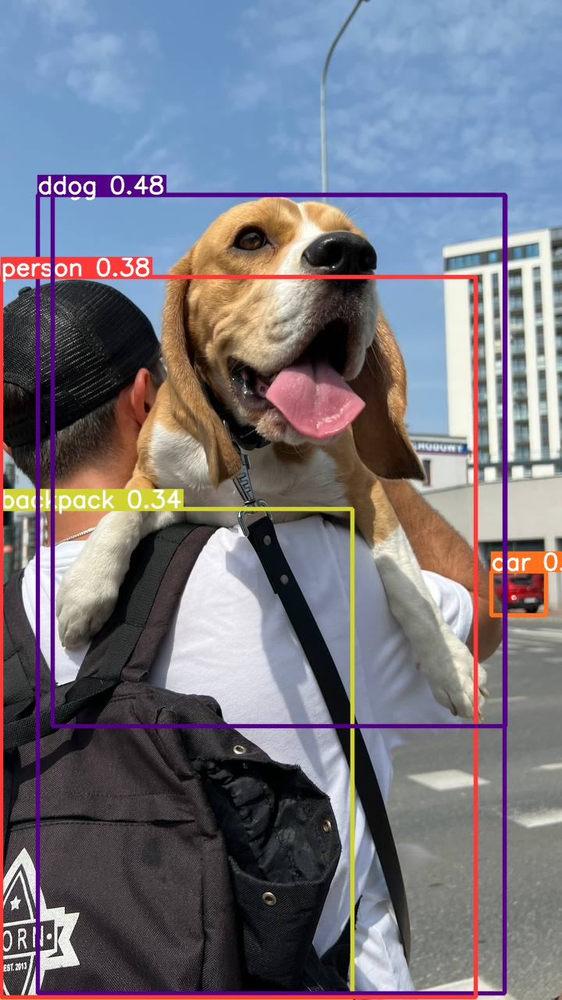

In [ ]:
from IPython.display import Image

Image(filename=f"{HOME}/yolov10/runs/detect/exp/dog.jpeg", width=600)

## Authenticate and Download the Dataset

**NOTE:** The dataset must be saved inside the `{HOME}/yolov9` directory, otherwise, the training will not succeed.

In [ ]:
%cd {HOME}/yolov10

/content/yolov10


In [ ]:
shutil.rmtree("/content/yolov10/Face-Detection-23")

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="k8GpPnuVWz5RcZRU6PfC")
project = rf.workspace("mohamed-traore-2ekkp").project("face-detection-mik1i")
version = project.version(15)
dataset = version.download("yolov9")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Face-Detection-15 in yolov9:: 100%|██████████| 6578/6578 [00:00<00:00, 6902.89it/s]


## Train Custom Model

In [ ]:
!pip -q install pyyaml

In [ ]:
import yaml

# Function to read a YAML file
def read_yaml(file_path):
    with open(file_path, 'r') as file:
        return yaml.safe_load(file)

# Function to write to a YAML file
def write_yaml(file_path, data):
    with open(file_path, 'w') as file:
        yaml.dump(data, file, default_flow_style=False)

In [ ]:
file_path = f'{dataset.location}/data.yaml'

# Read the YAML file
data = read_yaml(file_path)

In [ ]:
data['val'] = f'{dataset.location}/valid/images'
data['train'] = f'{dataset.location}/train/images'

In [ ]:
write_yaml(file_path, data)

In [ ]:
from ultralytics import YOLOv10

model = YOLOv10('/content/weights/yolov10s.pt')

model.train(data=f'{dataset.location}/data.yaml', epochs=25, batch=16, imgsz=640)

New https://pypi.org/project/ultralytics/8.2.42 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.34 🚀 Python-3.10.12 torch-2.0.1+cu117 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/weights/yolov10s.pt, data=/content/yolov10/Face-Detection-15/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, val_period=1, cache=False, device=None, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, 

100%|██████████| 755k/755k [00:00<00:00, 43.3MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1     36096  ultralytics.nn.modules.block.SCDown          [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1    137728  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 176MB/s]


AMP: checks passed ✅


train: Scanning /content/yolov10/Face-Detection-15/train/labels... 2871 images, 539 backgrounds, 0 corrupt: 100%|██████████| 2871/2871 [00:01<00:00, 1910.06it/s]


train: New cache created: /content/yolov10/Face-Detection-15/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
val: Scanning /content/yolov10/Face-Detection-15/valid/labels... 267 images, 50 backgrounds, 0 corrupt: 100%|██████████| 267/267 [00:00<00:00, 1009.63it/s]

val: New cache created: /content/yolov10/Face-Detection-15/valid/labels.cache


Plotting labels to /content/yolov10/runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 99 weight(decay=0.0), 112 weight(decay=0.0005), 111 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/yolov10/runs/detect/train5
Starting training for 25 epochs...

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


       1/25      5.31G      1.744      2.183      1.717      1.729      4.569      1.618         21        640: 100%|██████████| 180/180 [01:20<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.65it/s]

                   all        267        506     0.0968      0.148     0.0499     0.0198



      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


       2/25      5.87G      1.896      2.024      1.782      1.982      2.373      1.716         23        640: 100%|██████████| 180/180 [01:15<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.74it/s]


                   all        267        506        0.4      0.292      0.263      0.106

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


       3/25      5.57G      1.873      1.956       1.77      1.933      2.316      1.722         17        640: 100%|██████████| 180/180 [01:18<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.28it/s]


                   all        267        506      0.374      0.375      0.319      0.124

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


       4/25      5.66G      1.808      1.826      1.711      1.901      2.164      1.663         20        640: 100%|██████████| 180/180 [01:15<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.30it/s]


                   all        267        506      0.544      0.466      0.472       0.21

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


       5/25      5.67G       1.72      1.705      1.641      1.839      2.029      1.603         19        640: 100%|██████████| 180/180 [01:14<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.72it/s]

                   all        267        506      0.588      0.567      0.568      0.279



      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


       6/25      5.43G      1.672      1.603      1.608      1.804      1.887      1.567         15        640: 100%|██████████| 180/180 [01:18<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.12it/s]


                   all        267        506      0.625      0.421      0.487      0.226

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


       7/25      5.91G      1.639      1.506      1.567      1.745      1.791      1.524         16        640: 100%|██████████| 180/180 [01:15<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.19it/s]


                   all        267        506       0.68      0.601       0.66      0.334

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


       8/25      5.44G      1.569      1.428      1.532      1.692      1.706      1.502         14        640: 100%|██████████| 180/180 [01:14<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.78it/s]

                   all        267        506      0.777      0.573       0.67      0.341



      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


       9/25      5.87G      1.554      1.385      1.519      1.667      1.673      1.502         36        640: 100%|██████████| 180/180 [01:15<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.68it/s]

                   all        267        506      0.758      0.656      0.737      0.384



      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      10/25      5.87G      1.517      1.329      1.488      1.635      1.602      1.469         25        640: 100%|██████████| 180/180 [01:14<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  1.89it/s]


                   all        267        506      0.719      0.618        0.7      0.344

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      11/25      5.55G      1.487      1.304      1.472      1.622      1.537      1.465         15        640: 100%|██████████| 180/180 [01:15<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.26it/s]


                   all        267        506      0.757       0.65      0.726      0.412

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      12/25      5.66G      1.443      1.223      1.427      1.565       1.44      1.427         15        640: 100%|██████████| 180/180 [01:16<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.34it/s]


                   all        267        506      0.783      0.641      0.738      0.396

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      13/25      5.57G      1.425      1.222      1.419      1.546      1.464      1.417         11        640: 100%|██████████| 180/180 [01:13<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.76it/s]

                   all        267        506      0.771      0.659      0.735      0.396



      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      14/25      5.71G       1.41      1.185      1.388      1.527      1.432      1.378         21        640: 100%|██████████| 180/180 [01:13<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.19it/s]


                   all        267        506      0.839       0.67      0.775      0.424

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      15/25      5.87G      1.384      1.128      1.387      1.507      1.344      1.389         23        640: 100%|██████████| 180/180 [01:16<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.32it/s]


                   all        267        506      0.836      0.706      0.793      0.441
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      16/25      5.91G      1.337     0.9985      1.408      1.449      1.148      1.417          5        640: 100%|██████████| 180/180 [01:14<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.78it/s]

                   all        267        506      0.819      0.672      0.778      0.433



      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      17/25      5.55G      1.289     0.9329       1.37      1.399      1.052      1.392         17        640: 100%|██████████| 180/180 [01:10<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.67it/s]

                   all        267        506      0.816      0.698      0.778      0.442



      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      18/25      5.67G      1.275     0.9078      1.364      1.387      1.044       1.37         11        640: 100%|██████████| 180/180 [01:11<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.73it/s]

                   all        267        506      0.841      0.713      0.817      0.475



      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      19/25      5.88G      1.233      0.865      1.335      1.335       0.97      1.341         30        640: 100%|██████████| 180/180 [01:12<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.23it/s]


                   all        267        506      0.819      0.709      0.807      0.471

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      20/25       5.8G      1.189     0.8172      1.297      1.295     0.9131      1.309         20        640: 100%|██████████| 180/180 [01:13<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  1.88it/s]


                   all        267        506      0.794      0.719      0.794      0.465

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      21/25      5.88G       1.17     0.7836      1.281       1.28     0.8858      1.297         21        640: 100%|██████████| 180/180 [01:11<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.22it/s]


                   all        267        506      0.827      0.727      0.815      0.491

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      22/25      5.83G      1.125     0.7586      1.246      1.231     0.8545       1.26         12        640: 100%|██████████| 180/180 [01:10<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.08it/s]

                   all        267        506      0.853      0.735      0.835      0.502



      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      23/25      5.79G      1.104     0.7305      1.235      1.203     0.8188      1.253         11        640: 100%|██████████| 180/180 [01:13<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.14it/s]


                   all        267        506      0.846      0.706      0.815      0.485

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      24/25      5.79G      1.079     0.7047      1.205      1.188     0.7919      1.226          6        640: 100%|██████████| 180/180 [01:11<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.34it/s]


                   all        267        506      0.836      0.757      0.836       0.51

      Epoch    GPU_mem     box_om     cls_om     dfl_om     box_oo     cls_oo     dfl_oo  Instances       Size


      25/25      5.67G      1.044     0.6755      1.202      1.146     0.7564      1.212          9        640: 100%|██████████| 180/180 [01:12<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.20it/s]


                   all        267        506      0.855      0.749      0.838      0.512

25 epochs completed in 0.574 hours.
Optimizer stripped from /content/yolov10/runs/detect/train5/weights/last.pt, 16.5MB
Optimizer stripped from /content/yolov10/runs/detect/train5/weights/best.pt, 16.5MB

Validating /content/yolov10/runs/detect/train5/weights/best.pt...
Ultralytics YOLOv8.1.34 🚀 Python-3.10.12 torch-2.0.1+cu117 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10s summary (fused): 293 layers, 8035734 parameters, 0 gradients


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:09<00:00,  1.00s/it]


                   all        267        506      0.855      0.749      0.838      0.512
Speed: 9.4ms preprocess, 11.2ms inference, 0.0ms loss, 0.2ms postprocess per image
Results saved to /content/yolov10/runs/detect/train5


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x788e2cea1930>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

## Examine Training Results

In [ ]:
# !ls /content/yolov10/runs/detect/train2

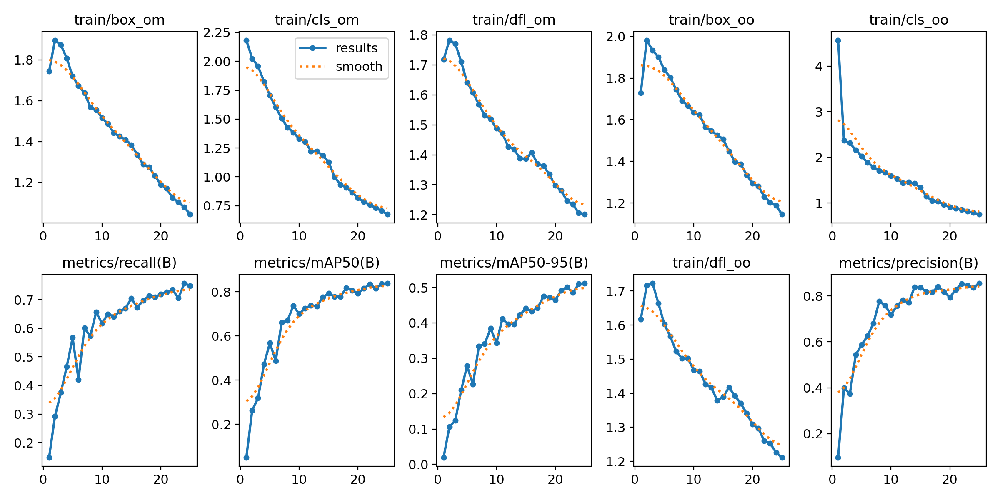

In [ ]:
from IPython.display import Image

Image(filename=f"/content/yolov10/runs/detect/train5/results.png", width=1000)

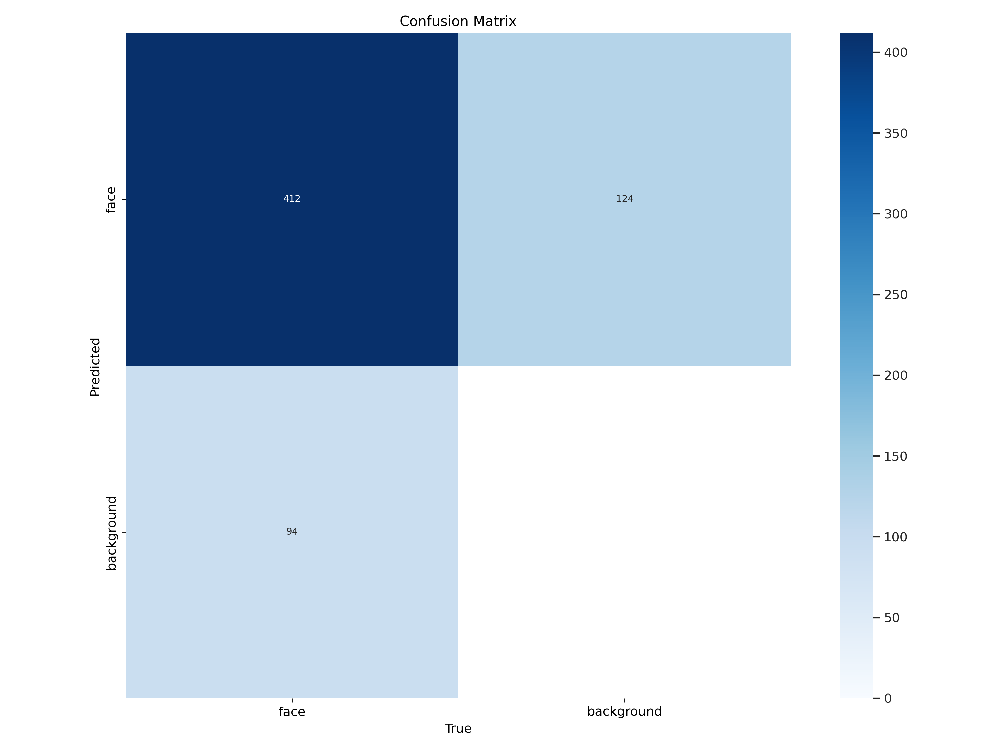

In [ ]:
from IPython.display import Image

Image(filename=f"/content/yolov10/runs/detect/train5/confusion_matrix.png", width=1000)

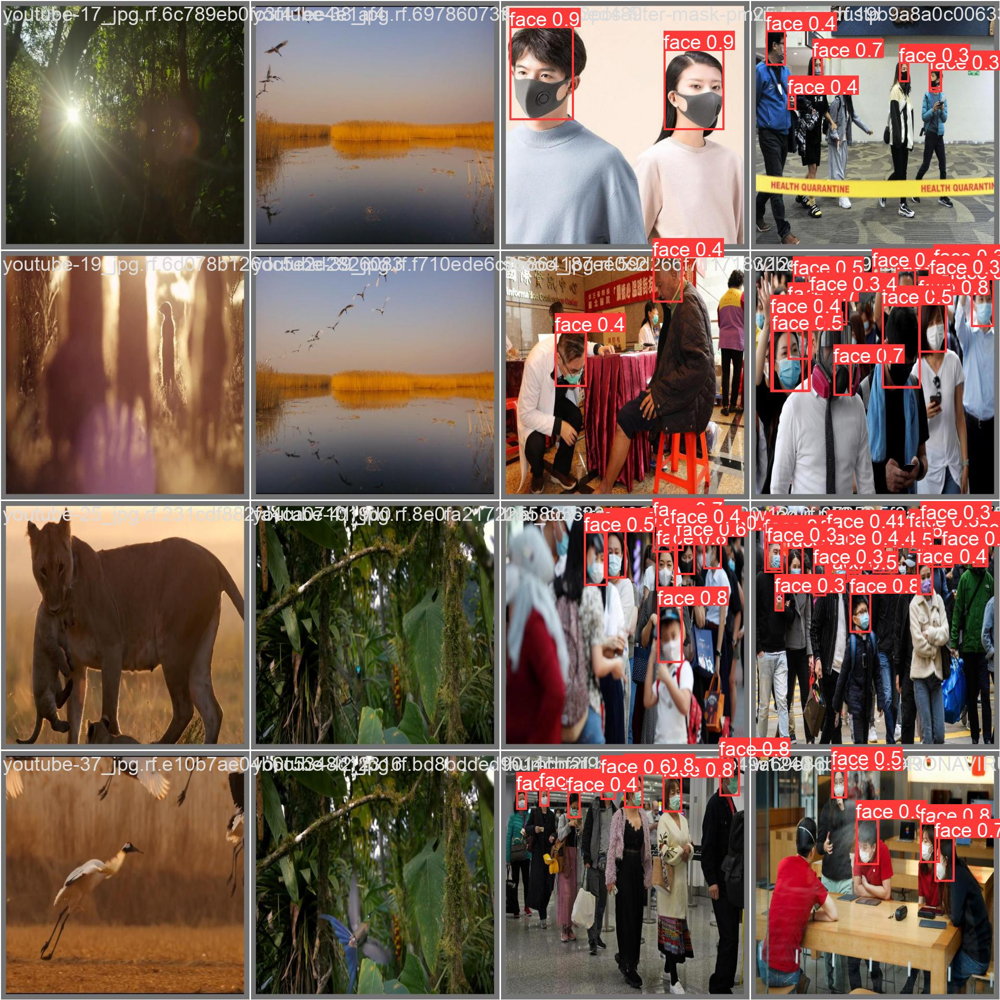

In [ ]:
from IPython.display import Image

Image(filename=f"/content/yolov10/runs/detect/train5/val_batch0_pred.jpg", width=1000)

## Validate Custom Model

In [ ]:
%cd {HOME}/yolov10

model.val(data=f'{dataset.location}/data.yaml', batch=256)

/content/yolov10
Ultralytics YOLOv8.1.34 🚀 Python-3.10.12 torch-2.0.1+cu117 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10s summary (fused): 293 layers, 8038056 parameters, 0 gradients


val: Scanning /content/yolov10/football-players-detection-9/valid/labels.cache... 43 images, 0 backgrounds, 0 corrupt: 100%|██████████| 43/43 [00:00<?, ?it/s]
os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.90s/it]


                   all         43       1025      0.827      0.668      0.737      0.464
                  ball         43         39          1      0.238      0.314     0.0694
            goalkeeper         43         32      0.778      0.719       0.87      0.612
                player         43        853       0.82      0.931      0.965        0.7
               referee         43        101       0.71      0.782      0.799      0.474
Speed: 0.1ms preprocess, 7.9ms inference, 0.0ms loss, 0.0ms postprocess per image
Results saved to /content/yolov10/runs/detect/train22


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c068917baf0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0

## Inference with Custom Model

In [ ]:
model = YOLOv10('/content/yolov10/runs/detect/train5/weights/best.pt')

In [ ]:
# results = model.predict(f"{dataset.location}/test/images")

In [ ]:
# # path to save the predictions
# results_path = f"{HOME}/yolov10/runs/detect/exp/"
# os.makedirs(results_path, exist_ok=True)
# # Display the results
# results[0].save(os.path.join(results_path, "dog.jpeg"))

In [ ]:
# from IPython.display import Image

# Image(filename=f"{HOME}/yolov10/runs/detect/exp/dog.jpeg", width=600)

In [ ]:
# !python detect.py \
# --img 1280 --conf 0.1 --device 0 \
# --weights {HOME}/yolov9/runs/train/exp/weights/best.pt \
# --source {dataset.location}/test/images

**NOTE:** Just like behore, the inference results have been saved in the appropriate directory inside `{HOME}/yolov9/runs/detect/`. Let's examine few of those results.

In [ ]:
# import glob

# from IPython.display import Image, display

# for image_path in glob.glob(f'{HOME}/yolov9/runs/detect/exp3/*.jpg')[:2]:
#       display(Image(filename=image_path, width=600))

## BONUS: Deploy YOLOv10 Model with Inference

**NOTE:** To deploy the model and display inference results, we will need two additional packages - [`inference`](https://pypi.org/project/inference) and [`supervision`](https://pypi.org/project/supervision). Let's install and import them!

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
print(HOME)

/content


In [ ]:
!pip -q install  inference supervision

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 414.0/414.0 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.0/124.0 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.2/59.2 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 24.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.8/91.8 kB 11.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 MB 14.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 252.0/252.0 kB 29.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.7/239.7 kB 31.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 80.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.0/66.0 kB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 327.4/327.4 kB 38.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.8/65.8 kB 9.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
import cv2

import random
import getpass

import supervision as sv
from inference import get_model

%matplotlib inline

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="k8GpPnuVWz5RcZRU6PfC")
project = rf.project("face-detection-rghlb")
version = project.version(1)

In [ ]:
version.deploy(model_type="yolov10", model_path=f"/content/yolov10/runs/detect/train5")

View the status of your deployment at: https://app.roboflow.com/projects-b9zgz/face-detection-rghlb/1
Share your model with the world at: https://universe.roboflow.com/projects-b9zgz/face-detection-rghlb/model/1


**NOTE:** Now we can download our model anywhere using the assigned `model_id` denoted by `[2]`. In my case `football-players-detection-3zvbc/6`. To download the model you will need your [`ROBOFLOW_API_KEY`](https://docs.roboflow.com/api-reference/authentication).




In [ ]:
ROBOFLOW_API_KEY = "k8GpPnuVWz5RcZRU6PfC"

model = get_model(model_id="face-detection-rghlb/1", api_key=ROBOFLOW_API_KEY)

**NOTE:** Let's pick random image from our test subset and detect objects using newly fine-tuned model.

In [ ]:
image_paths = sv.list_files_with_extensions(
    directory=f"{dataset.location}/test/images",
    extensions=['png', 'jpg', 'jpeg']
)

In [ ]:
image_path = random.choice(image_paths)
image = cv2.imread(str(image_path))

result = model.infer(image, confidence=0.1)[0]
detections = sv.Detections.from_inference(result)

**NOTE:** Finally, let's use supervision and [annotate](https://supervision.roboflow.com/develop/annotators/) our results.

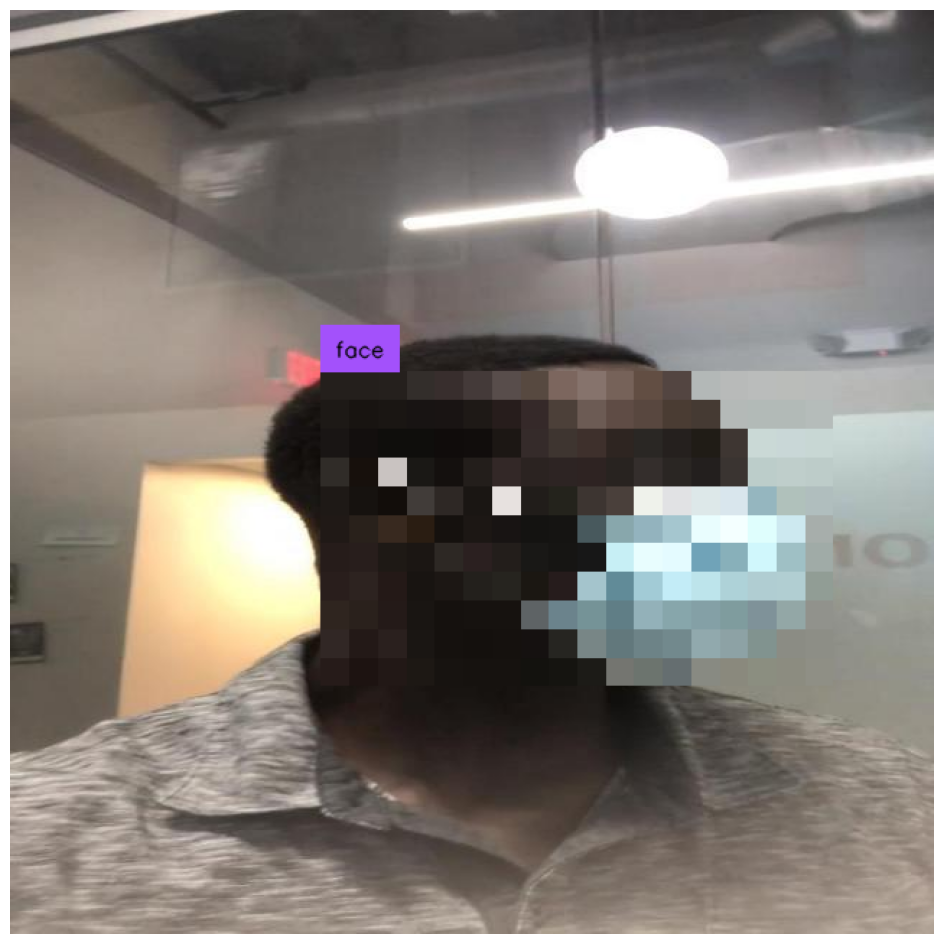

In [ ]:
label_annotator = sv.LabelAnnotator(text_color=sv.Color.BLACK)
pixelate_annotator = sv.PixelateAnnotator()

annotated_image = image.copy()
annotated_image = pixelate_annotator.annotate(scene=annotated_image, detections=detections)
annotated_image = label_annotator.annotate(scene=annotated_image, detections=detections)

sv.plot_image(annotated_image)

## Using Video as Input

In [ ]:
import cv2

from google.colab.patches import cv2_imshow

In [ ]:
video_source_path = "/content/people2.mp4"

In [ ]:
frame_generator = sv.get_video_frames_generator(source_path = video_source_path)
video_info = sv.VideoInfo.from_video_path(video_path = video_source_path)

In [ ]:
video_info

VideoInfo(width=1920, height=1080, fps=23, total_frames=460)

In [ ]:
CONFIDENCE_THRESHOLD = 0.1
IOU_THRESHOLD = 0.5

ELLIPSE_ANNOTATOR = sv.EllipseAnnotator()
LABEL_ANNOTATOR = sv.LabelAnnotator()
TRACE_ANNOTATOR = sv.TraceAnnotator()
PIXEL_ANNOTATOR = sv.PixelateAnnotator()

tracker = sv.ByteTrack()

In [ ]:
with sv.VideoSink(target_path='/content/BB_people_2.mp4', video_info=video_info) as sink:
  for frame in frame_generator:
      results = model.infer(frame,
                          confidence = CONFIDENCE_THRESHOLD,
                          iou_threshold = IOU_THRESHOLD
                          )[0]

      detections = sv.Detections.from_inference(results)
      detections = tracker.update_with_detections(detections)

      annotated_frame = frame.copy()

      annotated_frame = PIXEL_ANNOTATOR.annotate(scene=annotated_frame, detections=detections)

      labels = [
          f"#{tracker_id}" for tracker_id in detections.tracker_id
      ]

      annotated_frame = LABEL_ANNOTATOR.annotate(scene=annotated_frame,
                                                detections=detections,
                                                labels=labels)
      annotated_frame = TRACE_ANNOTATOR.annotate(
            scene=annotated_frame,
            detections=detections)

      sink.write_frame(frame=annotated_frame)

In [ ]:
# prompt: code to play video

from IPython.display import HTML
from base64 import b64encode
import cv2

def show_video(video_path, video_width = 600):
  """
  This function displays a video in the notebook.

  Args:
      video_path: The path to the video file.
      video_width: The desired width of the video in the notebook.
  """

  video_file = open(video_path, "rb").read()
  video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"

  # Display the video in an HTML5 video element
  display(HTML(f"""
  <video width="{video_width}" controls>
      <source src="{video_url}">
  </video>
  """))

# Example usage
video_path = "/content/BB_people_2.mp4"
show_video(video_path)
